# Data Exploration and Modelisation for Project 7 ML
**(Image classification)**

## Contents

1) <a href='#Sec.1'>Exploration</a>
    1) <a href='#Sec.1.1'>Number of images per dog breeds</a>
    1) <a href='#Sec.1.2'>Converting RGBA image into RGB image</a>
    1) <a href='#Sec.1.3'>Effect of upscaling low resolution images</a>
    1) <a href='#Sec.1.4'>Effect of downscaling high resolution images</a>
1) <a href='#Sec.2'>Modelisation</a>
    1) <a href='#Sec.2.1'>Loading the data</a>
    1) <a href='#Sec.2.2'>Pure CNN</a>
        1) <a href='#Sec.2.2.1'>Resnet-50 without data augmentation</a>
        1) <a href='#Sec.2.2.2'>Evaluating the best Resnet-50 model without augmentation on test images</a>
        1) <a href='#Sec.2.2.3'>Resnet-50 with data augmentation and training the last 3 blocks of the model</a>
        1) <a href='#Sec.2.2.4'>Evaluating the best Resnet-50 model with augmentation on test images</a>
    1) <a href='#Sec.2.3'>CNN+Transformer using a variant of maxvit</a>
        1) <a href='#Sec.2.3.1'>Maxxvit-v2-base without augmentation</a>
        1) <a href='#Sec.2.3.2'>Evaluating the best Maxxvit-v2-base model without augmentation on test images</a>
        1) <a href='#Sec.2.3.3'>Maxxvit-v2-base with augmentation and training the last stage</a>
        1) <a href='#Sec.2.3.4'>Evaluating the best Maxxvit-v2-base model with augmentation on test images
    1) <a href='#Sec.2.4'>Summary on the modelisation</a>

In [1]:
import timm

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

import torchvision
from torchvision import models
import torchvision.transforms as transforms

import gc
import time

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.metrics import *

import glob
from matplotlib.image import imread
from PIL import Image
import random

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


## <font id='Sec.1'> 1. Exploration

In [2]:
# Copy all images to working folder
from distutils.dir_util import copy_tree
from_dir = '/kaggle/input/stanford-dogs-dataset/images/Images/'
to_dir = '/kaggle/working/stanford-dogs-dataset/Images/'
copy_tree(from_dir,to_dir)

['/kaggle/working/stanford-dogs-dataset/Images/n02091635-otterhound/n02091635_965.jpg',
 '/kaggle/working/stanford-dogs-dataset/Images/n02091635-otterhound/n02091635_1329.jpg',
 '/kaggle/working/stanford-dogs-dataset/Images/n02091635-otterhound/n02091635_4698.jpg',
 '/kaggle/working/stanford-dogs-dataset/Images/n02091635-otterhound/n02091635_2120.jpg',
 '/kaggle/working/stanford-dogs-dataset/Images/n02091635-otterhound/n02091635_470.jpg',
 '/kaggle/working/stanford-dogs-dataset/Images/n02091635-otterhound/n02091635_6.jpg',
 '/kaggle/working/stanford-dogs-dataset/Images/n02091635-otterhound/n02091635_4174.jpg',
 '/kaggle/working/stanford-dogs-dataset/Images/n02091635-otterhound/n02091635_2112.jpg',
 '/kaggle/working/stanford-dogs-dataset/Images/n02091635-otterhound/n02091635_2305.jpg',
 '/kaggle/working/stanford-dogs-dataset/Images/n02091635-otterhound/n02091635_1408.jpg',
 '/kaggle/working/stanford-dogs-dataset/Images/n02091635-otterhound/n02091635_2018.jpg',
 '/kaggle/working/stanford

In [3]:
working_dir = '/kaggle/working/stanford-dogs-dataset/Images/'

image_list = []
for file in glob.glob(working_dir + '*/*.jpg'):
    image_list.append(file)

# Creating a dataframe about the location, name, and resolution of the images
dogs_image_df = pd.DataFrame(image_list, columns=['location'])
dogs_image_df['filename'] = dogs_image_df['location'].str.split('/').str.get(6)
dogs_image_df['breeds'] = dogs_image_df['location'].str.split('/').str.get(5).apply(lambda x: x.split('-')[1])
dogs_image_df['height'] = dogs_image_df['location'].apply(lambda x: imread(x).shape[0])
dogs_image_df['width'] = dogs_image_df['location'].apply(lambda x: imread(x).shape[1])
dogs_image_df['color'] = dogs_image_df['location'].apply(lambda x: imread(x).shape[2])

print('The number of total image = {} and the number of dog breeds = {}.'
      .format(dogs_image_df.shape[0], dogs_image_df['breeds'].nunique()))

dogs_image_df

The number of total image = 20580 and the number of dog breeds = 120.


,location,filename,breeds,height,width,color
0,/kaggle/working/stanford-dogs-dataset/Images/n...,n02107312_6098.jpg,miniature_pinscher,375,500,3
1,/kaggle/working/stanford-dogs-dataset/Images/n...,n02107312_281.jpg,miniature_pinscher,288,298,3
2,/kaggle/working/stanford-dogs-dataset/Images/n...,n02107312_2958.jpg,miniature_pinscher,500,332,3
3,/kaggle/working/stanford-dogs-dataset/Images/n...,n02107312_3470.jpg,miniature_pinscher,376,500,3
4,/kaggle/working/stanford-dogs-dataset/Images/n...,n02107312_7391.jpg,miniature_pinscher,375,500,3
...,...,...,...,...,...,...
20575,/kaggle/working/stanford-dogs-dataset/Images/n...,n02095314_252.jpg,wire,240,320,3
20576,/kaggle/working/stanford-dogs-dataset/Images/n...,n02095314_1577.jpg,wire,989,563,3
20577,/kaggle/working/stanford-dogs-dataset/Images/n...,n02095314_1583.jpg,wire,232,350,3
20578,/kaggle/working/stanford-dogs-dataset/Images/n...,n02095314_963.jpg,wire,202,298,3


In [4]:
dogs_image_df.describe()

,height,width,color
count,20580.000000,20580.000000,20580.000000
mean,385.861224,442.531876,3.000049
std,124.863446,142.792308,0.006971
min,100.000000,97.000000,3.000000
25%,333.000000,361.000000,3.000000
50%,375.000000,500.000000,3.000000
75%,453.000000,500.000000,3.000000
max,2562.000000,3264.000000,4.000000


- We see the height verying from 100 to 2562 pixels, and the width from 97 to 3264 pixels. We will need to put all images at the same resolution for the modelisation.
- We see as well few images are in RGBa format that will nedd to be transformed to RGB images.

### <font id='Sec.1.1'> A. Number of images per dog breeds

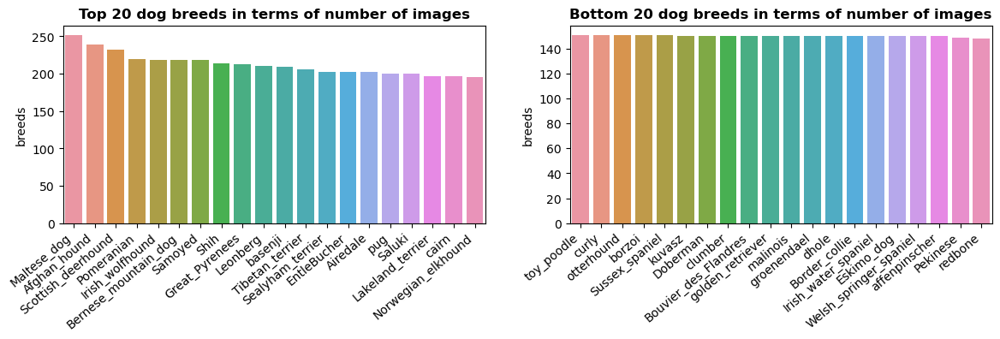

In [5]:
# Plotting number of images for each top 20 and worst 20 dog breeds
fig, axes = plt.subplots(1, 2, figsize=(14, 3))
sns.barplot(x=dogs_image_df['breeds'].value_counts()[:20].index,
            y=dogs_image_df['breeds'].value_counts()[:20], ax=axes[0])
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=40,
                        horizontalalignment='right')
axes[0].set_title('Top 20 dog breeds in terms of number of images',
                  fontsize=12, fontweight='bold')
sns.barplot(x=dogs_image_df['breeds'].value_counts()[-20:].index,
            y=dogs_image_df['breeds'].value_counts()[-20:], ax=axes[1])
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=40,
                        horizontalalignment='right')
axes[1].set_title('Bottom 20 dog breeds in terms of number of images',
                  fontsize=12, fontweight='bold')
plt.show()

All classes have between 150 and 250 images.

### <font id='Sec.1.2'> B. Converting RGBA image into RGB image

Shape of the original image: (189, 213, 4)


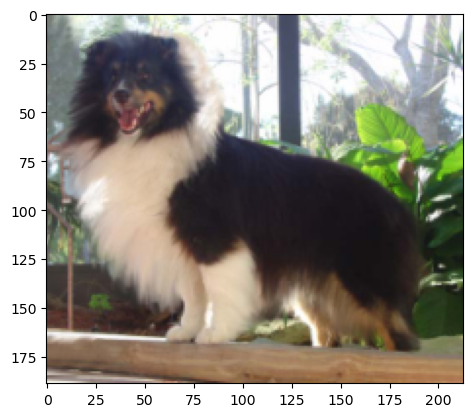

In [6]:
img_path = dogs_image_df.loc[dogs_image_df[dogs_image_df['color'] == 4].index[0], 'location']
print('Shape of the original image:', imread(img_path).shape)
plt.imshow(imread(img_path))

Shape of the converted image: (189, 213, 3)


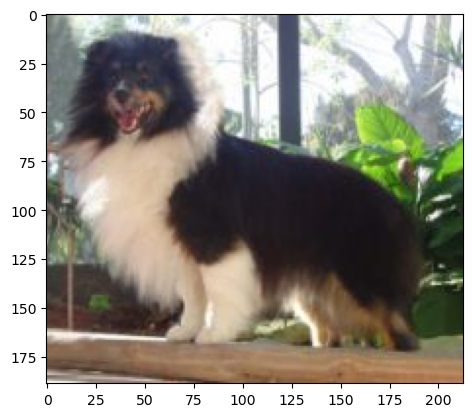

In [7]:
img = Image.open(img_path).convert('RGB')
img.save(img_path, 'JPEG', quality=80)
print('Shape of the converted image:', imread(img_path).shape)
plt.imshow(imread(img_path))

The conversion has no effect on the original image. Both looks the same.

### <font id='Sec.1.3'> C. Effect of upscaling low resolution images

In [8]:
print('Number of images with resolution lower than 224x224 = {} images.'
      .format(dogs_image_df[(dogs_image_df[['height', 'width']] < 224).any(axis=1)].shape[0]))

Number of images with resolution lower than 224x224 = 1577 images.


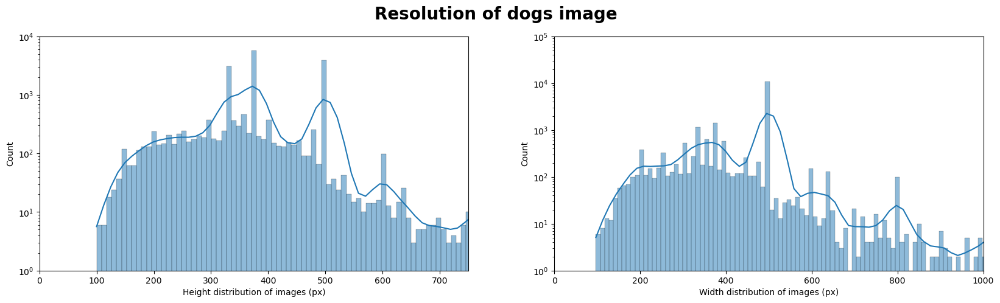

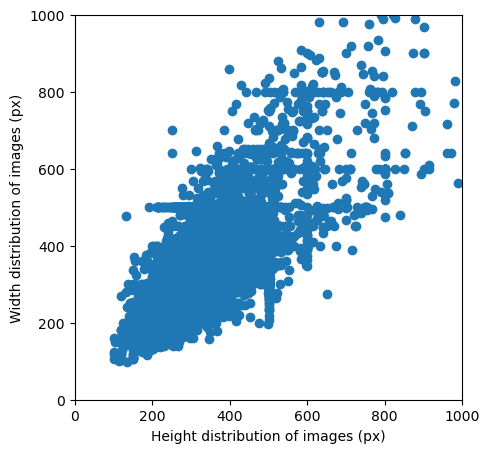

In [9]:
fig, axes = plt.subplots(1, 2, figsize=(20, 5))
sns.histplot(data=dogs_image_df, x='height',
             kde=True, ax=axes[0])
axes[0].set_xlabel('Height distribution of images (px)')
axes[0].set_xlim(0, dogs_image_df['height'].median()*2)
axes[0].set_ylim(1e0, 1e4)
axes[0].set_yscale('log')
sns.histplot(data=dogs_image_df, x='width',
             kde=True, ax=axes[1])
axes[1].set_xlabel('Width distribution of images (px)')
axes[1].set_xlim(0, dogs_image_df['width'].median()*2)
axes[1].set_ylim(1e0, 1e5)
axes[1].set_yscale('log')
plt.suptitle('Resolution of dogs image',
             fontsize=20, fontweight='bold')
plt.show()

plt.figure(figsize=(5, 5))
plt.plot(dogs_image_df['height'],
         dogs_image_df['width'], 'o')
plt.xlabel('Height distribution of images (px)')
plt.ylabel('Width distribution of images (px)')
plt.xlim(0, 1000)
plt.ylim(0, 1000)
plt.show()

Shape of the original image: (134, 97, 3)
Shape of the resized image: (224, 224)


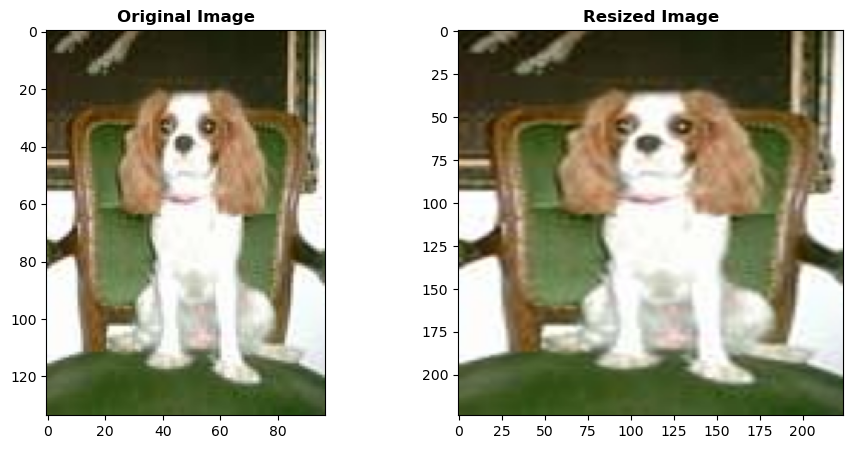

In [10]:
img_path = dogs_image_df.loc[dogs_image_df[dogs_image_df['width'] == dogs_image_df['width'].min()].index[0], 'location']
print('Shape of the original image:', imread(img_path).shape)
img = Image.open(img_path).resize((224, 224))
print('Shape of the resized image:', img.size)

fig, axes = plt.subplots(1, 2, figsize=(11, 5))

axes[0].imshow(imread(img_path))
axes[0].set_title('Original Image',
                  fontsize=12, fontweight='bold')
axes[1].imshow(img)
axes[1].set_title('Resized Image',
                  fontsize=12, fontweight='bold')

plt.show()

Shape of the original image: (100, 125, 3)
Shape of the resized image: (224, 224)


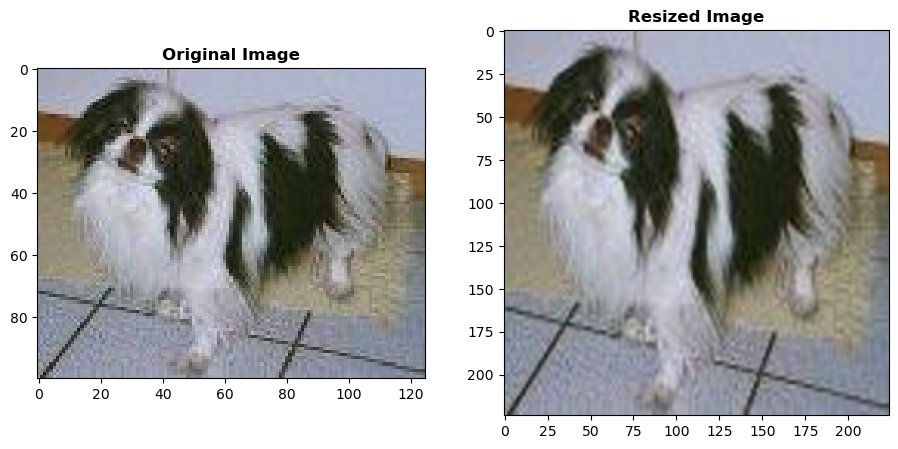

In [11]:
img_path = dogs_image_df.loc[dogs_image_df[dogs_image_df['height'] == dogs_image_df['height'].min()].index[0], 'location']
print('Shape of the original image:', imread(img_path).shape)
img = Image.open(img_path).resize((224, 224))
print('Shape of the resized image:', img.size)

fig, axes = plt.subplots(1, 2, figsize=(11, 5))

axes[0].imshow(imread(img_path))
axes[0].set_title('Original Image',
                  fontsize=12, fontweight='bold')
axes[1].imshow(img)
axes[1].set_title('Resized Image',
                  fontsize=12, fontweight='bold')

plt.show()

### <font id='Sec.1.4'> D. Effect of downscaling high resolution images

Shape of the original image: (2448, 3264, 3)
Shape of the resized image: (224, 224)


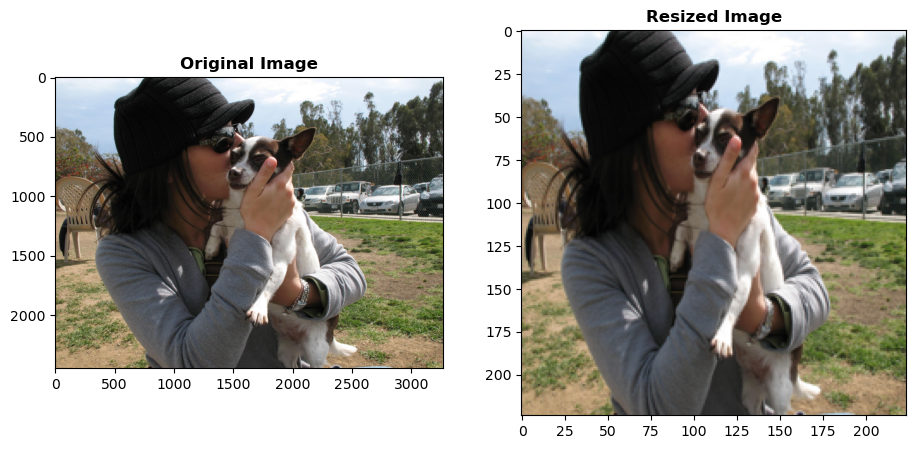

In [12]:
img_path = dogs_image_df.loc[dogs_image_df[dogs_image_df['width'] == dogs_image_df['width'].max()].index[0], 'location']
print('Shape of the original image:', imread(img_path).shape)
img = Image.open(img_path).resize((224, 224))
print('Shape of the resized image:', img.size)

fig, axes = plt.subplots(1, 2, figsize=(11, 5))

axes[0].imshow(imread(img_path))
axes[0].set_title('Original Image',
                  fontsize=12, fontweight='bold')
axes[1].imshow(img)
axes[1].set_title('Resized Image',
                  fontsize=12, fontweight='bold')

plt.show()

Shape of the original image: (2562, 2388, 3)
Shape of the resized image: (224, 224)


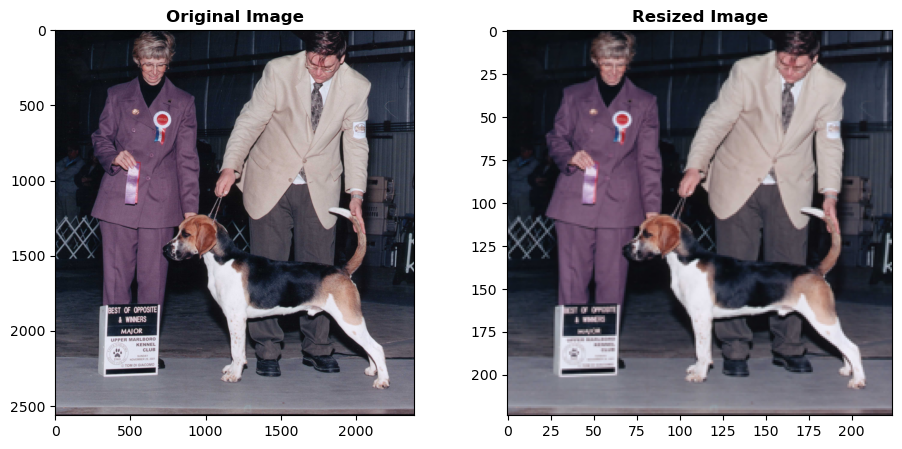

In [13]:
img_path = dogs_image_df.loc[dogs_image_df[dogs_image_df['height'] == dogs_image_df['height'].max()].index[0], 'location']
print('Shape of the original image:', imread(img_path).shape)
img = Image.open(img_path).resize((224, 224))
print('Shape of the resized image:', img.size)

fig, axes = plt.subplots(1, 2, figsize=(11, 5))

axes[0].imshow(imread(img_path))
axes[0].set_title('Original Image',
                  fontsize=12, fontweight='bold')
axes[1].imshow(img)
axes[1].set_title('Resized Image',
                  fontsize=12, fontweight='bold')

plt.show()

## <font id='Sec.2'> 2. Modelisation

### <font id='Sec.2.1'> A. Loading the data

In [14]:
# Without data augmentation
transform = transforms.Compose([transforms.Resize((224, 224)),
                                transforms.ToTensor(),
                               ])

data = torchvision.datasets.ImageFolder('/kaggle/working/stanford-dogs-dataset/Images',
                                        transform=transform)

# With data augmentation
transform_aug = transforms.Compose([transforms.Resize((224, 224)),
                                    transforms.RandomHorizontalFlip(),
                                    transforms.ColorJitter(brightness=.25, contrast=.25),
                                    transforms.RandomRotation(30),
                                    transforms.ToTensor(),
                                   ])

data_aug = torchvision.datasets.ImageFolder('/kaggle/working/stanford-dogs-dataset/Images',
                                            transform=transform_aug)

class_names = data.classes
dog_breeds = [name.split('-', 1)[1] for name in class_names]
print('Class names of some dog breeds:', dog_breeds[:5])
num_classes = len(class_names)
print('Number of dog breeds in the dataset:', num_classes)
#joblib.dump(dog_breeds, 'dog_breeds.pkl')

Class names of some dog breeds: ['Chihuahua', 'Japanese_spaniel', 'Maltese_dog', 'Pekinese', 'Shih-Tzu']
Number of dog breeds in the dataset: 120


In [15]:
# Splitting the data in 80% train, 10% validation, and 10% test
generator = torch.Generator().manual_seed(42)
train, val, test = torch.utils.data.random_split(data, [0.8, 0.1, 0.1], generator=generator)
train_aug, val_aug, test_aug = torch.utils.data.random_split(data_aug, [0.8, 0.1, 0.1], generator=generator)

In [16]:
del data, generator, transform
del data_aug, transform_aug

In [17]:
# Creating data loader with batch of 42 images each for train and validation set
BATCH_SIZE = 42

train_loader = DataLoader(train, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val, batch_size=BATCH_SIZE, shuffle=True)
test_loader = DataLoader(test, batch_size=1, shuffle=False)

train_loader_aug = DataLoader(train_aug, batch_size=BATCH_SIZE, shuffle=True)
val_loader_aug = DataLoader(val_aug, batch_size=BATCH_SIZE, shuffle=True)
test_loader_aug = DataLoader(test_aug, batch_size=1, shuffle=False)

In [18]:
del train, test, val
del train_aug, test_aug, val_aug

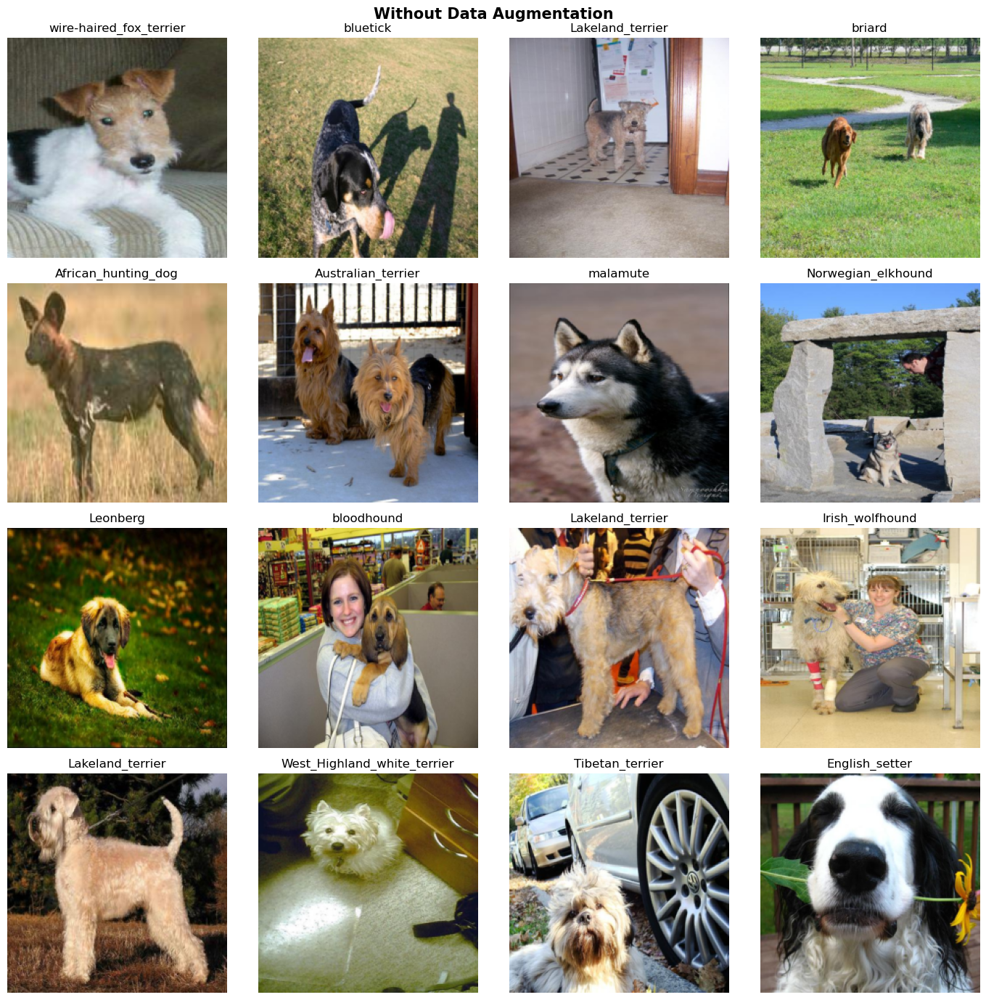

In [19]:
iterator = iter(train_loader)

fig, axes = plt.subplots(4, 4, figsize=(14, 14))
axes = axes.ravel()

for i in range(16):
    image, label = next(iterator)
    # Plot the image with label
    axes[i].imshow(np.squeeze(image[0]).permute(1, 2, 0))
    axes[i].set_title(dog_breeds[label[0]])
    axes[i].axis("off")

plt.suptitle('Without Data Augmentation', fontsize=15, fontweight='bold')
plt.tight_layout()
plt.show()

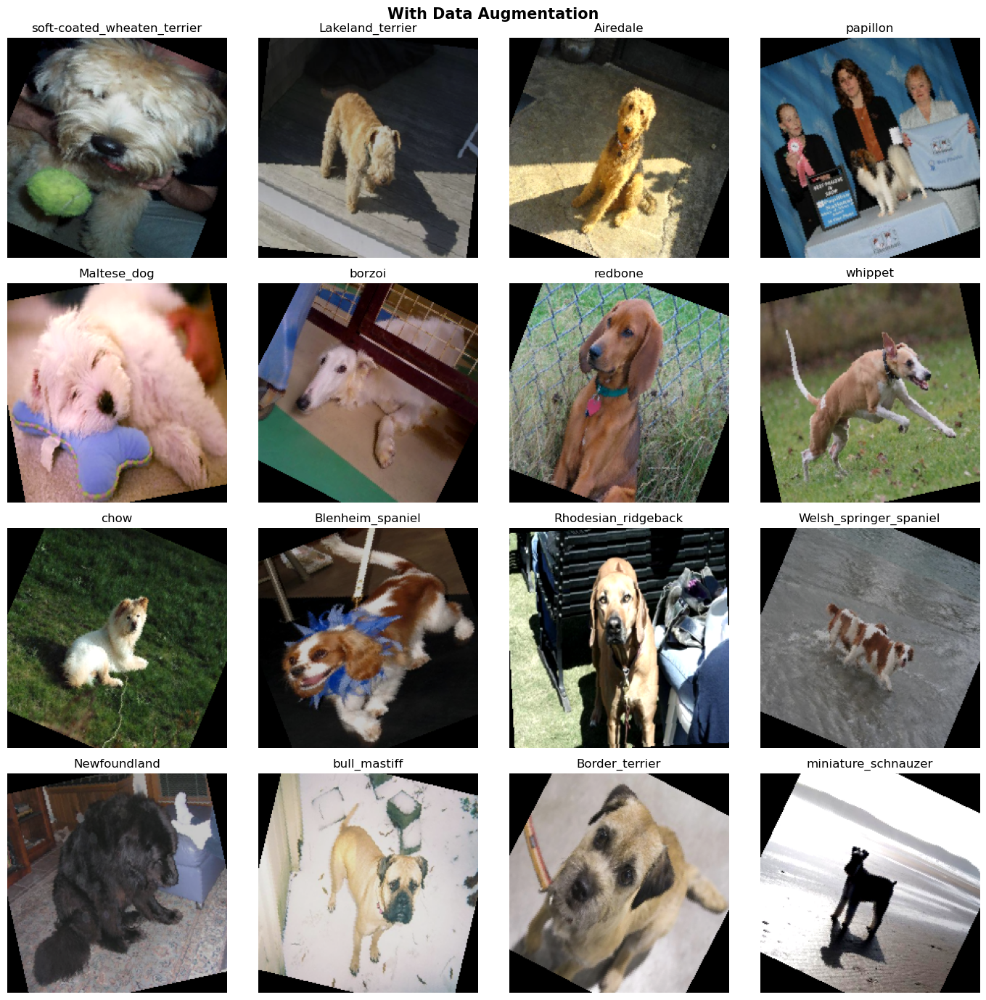

In [20]:
iterator = iter(train_loader_aug)

fig, axes = plt.subplots(4, 4, figsize=(14, 14))
axes = axes.ravel()

for i in range(16):
    image, label = next(iterator)
    # Plot the image with labels
    axes[i].imshow(np.squeeze(image[0]).permute(1, 2, 0))
    axes[i].set_title(dog_breeds[label[0]])
    axes[i].axis("off")

plt.suptitle('With Data Augmentation', fontsize=15, fontweight='bold')
plt.tight_layout()
plt.show()

In [21]:
del iterator

### <font id='Sec.2.2'> B. Pure CNN usisng Resnet-50
    Source code of the model: https://github.com/huggingface/pytorch-image-models/blob/main/timm/models/resnet.py
    Related publications:
    - ResNet strikes back: An improved training procedure in timm: https://arxiv.org/abs/2110.00476
    - Deep Residual Learning for Image Recognition: https://arxiv.org/abs/1512.03385

#### <font id='Sec.2.2.1'> a) Resnet-50 without data augmentation

In [22]:
# Load the model
model = timm.create_model('resnet50',
                          pretrained=True,
                          drop_rate=0.2,
                         )
print('Classifier layer:', model.get_classifier())
print(model)

Classifier layer: Linear(in_features=2048, out_features=1000, bias=True)
ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (act1): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (act1): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (drop_block): Identity()
      (act2): ReLU(inplace=True)
      (aa): Identity()
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(2

In [23]:
# Freeze all layers
for param in model.parameters():
    param.requires_grad = False

# Adapt the classification layer to the 120 classes
model.fc = nn.Linear(model.fc.in_features, num_classes)

# Use GPU if available otherwise CPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)
model.to(device)

cuda


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (act1): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (act1): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (drop_block): Identity()
      (act2): ReLU(inplace=True)
      (aa): Identity()
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     

In [24]:
# Check the classification layer
model.get_classifier()

Linear(in_features=2048, out_features=120, bias=True)

In [25]:
# Define error and optimizer
error = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [26]:
# Define early stop to be used during the training
class EarlyStopper:
    def __init__(self, patience=1, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.min_validation_loss = np.inf

    def early_stop(self, validation_loss):
        if validation_loss < self.min_validation_loss:
            self.min_validation_loss = validation_loss
            self.counter = 0
        elif validation_loss > (self.min_validation_loss + self.min_delta):
            self.counter += 1
            if self.counter >= self.patience:
                return True
        return False

In [27]:
early_stopper = EarlyStopper(patience=5, min_delta=0.01)

num_epochs = 15

# Lists for visualization of loss and accuracy 
train_loss_list = []
val_loss_list = []
train_accuracy_list = []
val_accuracy_list = []

# Lists for knowing classwise accuracy
predictions_list = []
labels_list = []

len_train = len(train_loader)
len_val = len(val_loader)

best_loss = 1000

for epoch in range(num_epochs):
    print(f"Start of Epoch {epoch+1} of {num_epochs}")
    total_train = 0
    train_correct = 0
    train_loss = 0

    model.train()

    start = time.time()

    for it,(images, labels) in enumerate(train_loader):
        print(f'Train: {(it*100/len_train):.2f}% done out of {len_train} batch', end='\r')

        # Transfering images and labels to GPU if available
        images, labels = images.to(device), labels.to(device)

        # Forward pass 
        outputs = model(images)
        loss = error(outputs, labels)

        # update average validation loss
        train_loss += loss

        predictions = torch.max(outputs, 1)[1].to(device)
        train_correct += torch.sum(predictions == labels).item()
        total_train += len(labels)

        # Initializing a gradient as 0 so there is no mixing of gradient among the batches
        optimizer.zero_grad()

        # Propagating the error backward
        loss.backward()

        # Optimizing the parameters
        optimizer.step()

    print()

    # Testing the model

    total_val = 0
    val_correct = 0
    val_loss = 0

    model.eval()

    with torch.no_grad():
        for it, (images, labels) in enumerate(val_loader):
            print(f'Validation: {(it*100/len_val):.2f}% done out of {len_val} batch', end='\r')

            images, labels = images.to(device), labels.to(device)
            labels_list.append(labels)

            outputs = model(images)
            loss = error(outputs, labels)

            # update average validation loss
            val_loss += loss

            predictions = torch.max(outputs, 1)[1].to(device)
            val_correct += torch.sum(predictions == labels).item()
            total_val += len(labels)
 
    stop = time.time()
    training_time = stop - start

    val_accuracy = val_correct / total_val
    train_accuracy = train_correct / total_train
    val_accuracy_list.append(val_accuracy)
    train_accuracy_list.append(train_accuracy)
    val_loss = val_loss.tolist() / len_val
    train_loss = train_loss.tolist() / len_train
    val_loss_list.append(val_loss)
    train_loss_list.append(train_loss)

    print()

    # Saving the best model with the best validation loss
    if (val_loss < best_loss):
        best_loss = val_loss
        torch.save(model.state_dict(), f'RN_best_model.pth')
        print('Saving best model with best loss = ', best_loss)

    print("Epoch: {}, training_time: {:.2f}s, train_loss: {:.3f}, train_accuracy: {:.3f}, val_loss: {:.3f}, val_accuracy: {:.3f}\n"
          .format(epoch+1, training_time, train_loss, train_accuracy, val_loss, val_accuracy))

    # Early stop the training if no improvement since 5 epochs
    if early_stopper.early_stop(val_loss):             
        break

Start of Epoch 1 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  1.8086745593012596
Epoch: 1, training_time: 109.32s, train_loss: 3.022, train_accuracy: 0.554, val_loss: 1.809, val_accuracy: 0.761

Start of Epoch 2 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  1.1305163636499522
Epoch: 2, training_time: 103.31s, train_loss: 1.373, train_accuracy: 0.784, val_loss: 1.131, val_accuracy: 0.789

Start of Epoch 3 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  0.943656687833825
Epoch: 3, training_time: 102.19s, train_loss: 0.955, train_accuracy: 0.821, val_loss: 0.944, val_accuracy: 0.795

Start of Epoch 4 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  0.8261553705955038
Epoch: 4, training_time: 102.54s, train_los

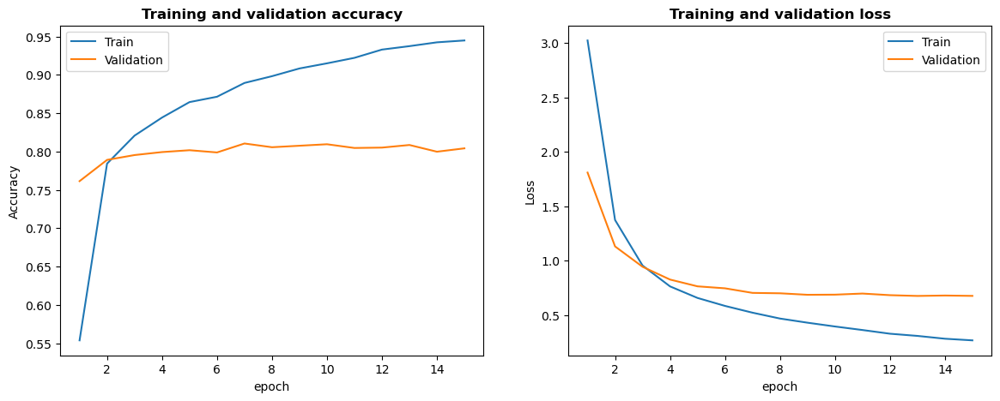

In [28]:
# Checking the accuracy and loss by epoch for both training and validation
epochs = range(1,  len(train_loss_list)+1)

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

axes[0].plot(epochs, train_accuracy_list)
axes[0].plot(epochs, val_accuracy_list)
axes[0].set_title('Training and validation accuracy',
                  fontsize=12, fontweight='bold')
axes[0].set_ylabel('Accuracy')
axes[0].set_xlabel('epoch') 
axes[0].legend(['Train', 'Validation'], loc='upper left')

axes[1].plot(epochs, train_loss_list)
axes[1].plot(epochs, val_loss_list)
axes[1].set_title('Training and validation loss',
                  fontsize=12, fontweight='bold')
axes[1].set_ylabel('Loss')
axes[1].set_xlabel('epoch') 
axes[1].legend(['Train', 'Validation'], loc='upper right')

plt.show()

#### <font id='Sec.2.2.2'> b) Evaluating the best Resnet-50 model without augmentation on test images

In [29]:
# Loading the model with the best weights obtained earlier
model = timm.create_model('resnet50')
model.fc = nn.Linear(model.fc.in_features, num_classes)
model.load_state_dict(torch.load("./RN_best_model.pth"))

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
model.to(device)

model.eval()

# This turns gradient calculations off for the test
torch.set_grad_enabled(False)

cuda


In [30]:
error = nn.CrossEntropyLoss()

len_test = len(test_loader)
test_loss = 0
test_correct = 0
total_test = 0

predicted_labels = []
true_labels = []

start = time.time()

for it, (images, labels) in enumerate(test_loader):
    print(f'Validation: {(it*100/len_test):.2f}% done out of {len_test} images', end='\r')
    images, labels = images.to(device), labels.to(device)
    outputs = model(images)
    loss = error(outputs, labels)
    # update average validation loss
    test_loss += loss
    
    predictions = torch.max(outputs, 1)[1].to(device)
    predicted_labels.append(predictions.tolist())
    true_labels.append(labels.tolist())
    test_correct += torch.sum(predictions == labels).item()

    total_test += len(labels)

stop = time.time()
test_time = stop - start

test_accuracy = test_correct / total_test
test_loss = test_loss.tolist() / len_test
    
print("Test time: {:.2f}s, test_loss: {:.3f}, test_accuracy: {:.3f}\n"
      .format(test_time, test_loss, test_accuracy))

score = []
score.append(['Resnet50', training_time, test_time, test_loss, test_accuracy])

Test time: 23.62s, test_loss: 0.679, test_accuracy: 0.813



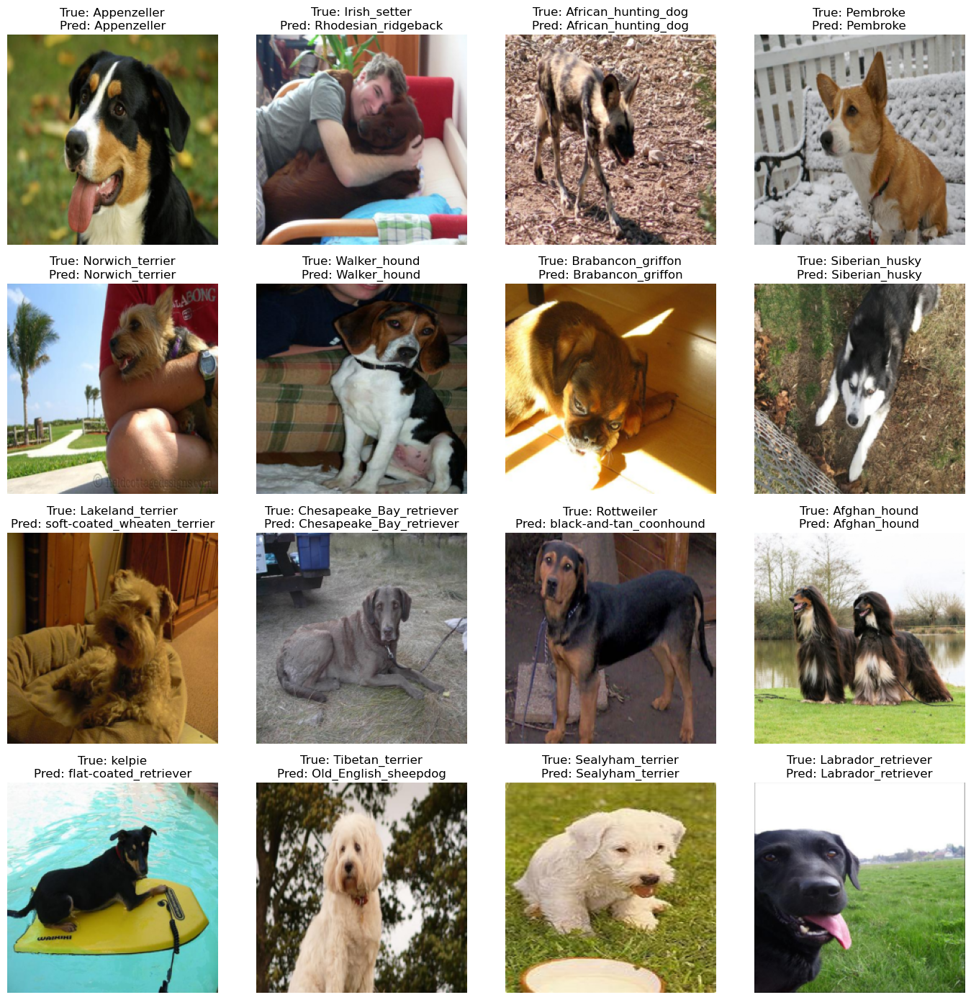

In [31]:
# Checking few images from the test data
iterator = iter(test_loader)

fig, axes = plt.subplots(4, 4, figsize=(14, 14))
axes = axes.ravel()

for i in range(16):
    image, label = next(iterator)
    pred_class = model(image.to(device)).softmax(1).argmax(1)
    # Plot the image with true and predicted labels
    axes[i].imshow(np.squeeze(image).permute(1, 2, 0))
    axes[i].set_title(f"True: {dog_breeds[label]}\nPred: {dog_breeds[pred_class]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

In [32]:
# Function that will plot recall score for top 20 and worst 20 dog breed
def score_per_class(ytest, ypred, dog_breeds):
    # Generating recall score for each class
    score_class = recall_score(ytest, ypred, average=None)
    class_df=pd.DataFrame()
    i = 0
    for breed in dog_breeds:
        class_df.loc[i,'dog_breed']= breed
        class_df.loc[i,'score']= score_class[i]
        i += 1
    class_df = class_df.sort_values('score', ascending=False)
    
    # Plotting recall score for each top 20 and worst 20 dog breeds
    fig, axes = plt.subplots(1, 2, figsize=(14, 3))
    sns.barplot(data=class_df.iloc[:20], x='dog_breed',
                y='score', ax=axes[0])
    axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=40,
                            horizontalalignment='right')
    axes[0].set_title('Recall score for the top 20 dog breeds',
                      fontsize=15, fontweight='bold')
    sns.barplot(data=class_df.iloc[-20:], x='dog_breed',
                y='score', ax=axes[1])
    axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=40,
                            horizontalalignment='right')
    axes[1].set_title('Recall score for the worst 20 dog_breeds',
                      fontsize=15, fontweight='bold')
    plt.show()

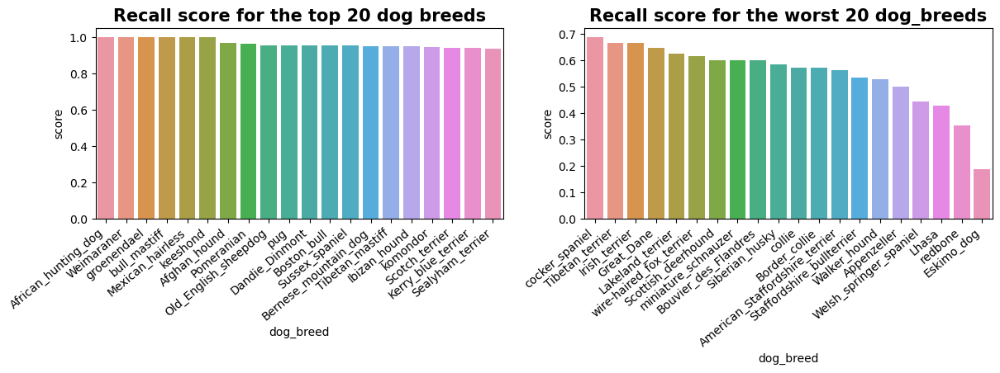

In [33]:
score_per_class(true_labels, predicted_labels, dog_breeds)

In [34]:
print(classification_report(true_labels, predicted_labels, target_names=dog_breeds))

                                precision    recall  f1-score   support

                     Chihuahua       0.94      0.83      0.88        18
              Japanese_spaniel       0.92      0.86      0.89        14
                   Maltese_dog       0.77      0.74      0.76        23
                      Pekinese       1.00      0.88      0.94        17
                      Shih-Tzu       0.62      0.84      0.71        19
              Blenheim_spaniel       0.93      0.93      0.93        14
                      papillon       1.00      0.88      0.93        16
                   toy_terrier       0.93      0.76      0.84        17
           Rhodesian_ridgeback       0.70      0.74      0.72        19
                  Afghan_hound       1.00      0.97      0.98        29
                        basset       0.85      0.92      0.88        12
                        beagle       0.73      0.76      0.74        21
                    bloodhound       0.88      0.78      0.82  

In [35]:
del model, iterator

#### <font id='Sec.2.2.3'> c) Resnet-50 with data augmentation and training the last 3 blocks of the model

In [36]:
# Loading the model
model = timm.create_model('resnet50',
                          pretrained=True,
                          drop_rate=0.2,
                         )
print('Classifier layer:', model.get_classifier())
print(model)

Classifier layer: Linear(in_features=2048, out_features=1000, bias=True)
ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (act1): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (act1): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (drop_block): Identity()
      (act2): ReLU(inplace=True)
      (aa): Identity()
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(2

In [37]:
# turns gradient calculations back on for training the few of the last layers
torch.set_grad_enabled(True)

for param in model.parameters():
    param.requires_grad = False

# model.layer4 covers the last 3 blocks of the model
for param in model.layer4.parameters():
    param.requires_grad = True
    
for param in model.global_pool.parameters():
    param.requires_grad = True

model.fc = nn.Linear(model.fc.in_features, num_classes)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)
model.to(device)

cuda


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (act1): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (act1): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (drop_block): Identity()
      (act2): ReLU(inplace=True)
      (aa): Identity()
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     

In [38]:
model.get_classifier()

Linear(in_features=2048, out_features=120, bias=True)

In [39]:
error = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [40]:
early_stopper = EarlyStopper(patience=5, min_delta=0.01)

num_epochs = 15
# Lists for visualization of loss and accuracy 
train_loss_list = []
val_loss_list = []
train_accuracy_list = []
val_accuracy_list = []

# Lists for knowing classwise accuracy
predictions_list = []
labels_list = []

len_train = len(train_loader_aug)
len_val = len(val_loader_aug)

best_loss = 1000

for epoch in range(num_epochs):
    print(f"Start of Epoch {epoch+1} of {num_epochs}")
    total_train = 0
    train_correct = 0
    train_loss = 0

    model.train()

    start = time.time()

    for it,(images, labels) in enumerate(train_loader_aug):
        print(f'Train: {(it*100/len_train):.2f}% done out of {len_train} batch', end='\r')

        # Transfering images and labels to GPU if available
        images, labels = images.to(device), labels.to(device)

        # Forward pass 
        outputs = model(images)
        loss = error(outputs, labels)

        # update average validation loss
        train_loss += loss

        predictions = torch.max(outputs, 1)[1].to(device)
        train_correct += torch.sum(predictions == labels).item()
        total_train += len(labels)

        # Initializing a gradient as 0 so there is no mixing of gradient among the batches
        optimizer.zero_grad()

        # Propagating the error backward
        loss.backward()

        # Optimizing the parameters
        optimizer.step()

    print()

    # Testing the model

    total_val = 0
    val_correct = 0
    val_loss = 0

    model.eval()

    with torch.no_grad():
        for it, (images, labels) in enumerate(val_loader_aug):
            print(f'Validation: {(it*100/len_val):.2f}% done out of {len_val} batch', end='\r')

            images, labels = images.to(device), labels.to(device)
            labels_list.append(labels)

            outputs = model(images)
            loss = error(outputs, labels)

            # update average validation loss
            val_loss += loss

            predictions = torch.max(outputs, 1)[1].to(device)
            val_correct += torch.sum(predictions == labels).item()
            total_val += len(labels)

    stop = time.time()
    training_time = stop - start

    val_accuracy = val_correct / total_val
    train_accuracy = train_correct / total_train
    val_accuracy_list.append(val_accuracy)
    train_accuracy_list.append(train_accuracy)
    val_loss = val_loss.tolist() / len_val
    train_loss = train_loss.tolist() / len_train
    val_loss_list.append(val_loss)
    train_loss_list.append(train_loss)

    print()

    if (val_loss < best_loss):
        best_loss = val_loss
        torch.save(model.state_dict(), f'RN_aug_best_model.pth')
        print('Saving best model with best loss = ', best_loss)

    print("Epoch: {}, training_time: {:.2f}s, train_loss: {:.3f}, train_accuracy: {:.3f}, val_loss: {:.3f}, val_accuracy: {:.3f}\n"
          .format(epoch+1, training_time, train_loss, train_accuracy, val_loss, val_accuracy))

    if early_stopper.early_stop(val_loss):             
        break

Start of Epoch 1 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  0.8316799085967395
Epoch: 1, training_time: 137.29s, train_loss: 1.530, train_accuracy: 0.616, val_loss: 0.832, val_accuracy: 0.759

Start of Epoch 2 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  0.8107227403290418
Epoch: 2, training_time: 135.88s, train_loss: 0.765, train_accuracy: 0.772, val_loss: 0.811, val_accuracy: 0.767

Start of Epoch 3 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  0.805861336844308
Epoch: 3, training_time: 136.12s, train_loss: 0.599, train_accuracy: 0.815, val_loss: 0.806, val_accuracy: 0.771

Start of Epoch 4 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  0.7635841369628906
Epoch: 4, training_time: 137.33s, train_los

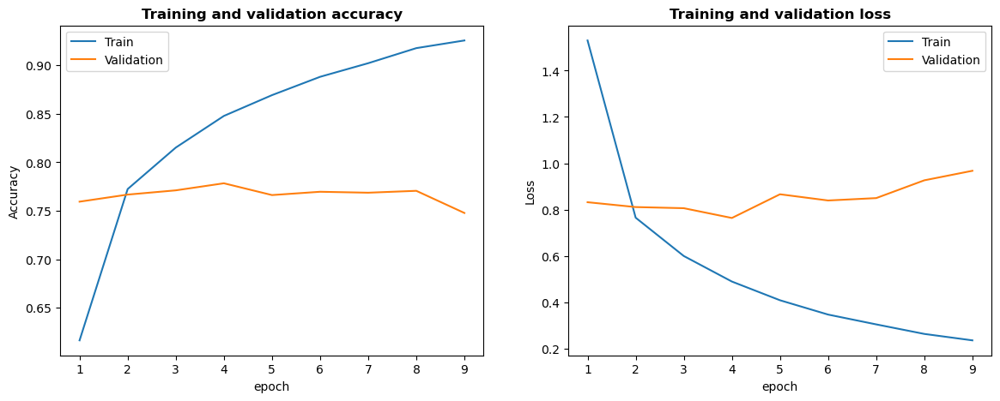

In [41]:
# Checking the accuracy and loss by epoch for both training and validation
epochs = range(1,  len(train_loss_list)+1)

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

axes[0].plot(epochs, train_accuracy_list)
axes[0].plot(epochs, val_accuracy_list)
axes[0].set_title('Training and validation accuracy',
                  fontsize=12, fontweight='bold')
axes[0].set_ylabel('Accuracy')
axes[0].set_xlabel('epoch') 
axes[0].legend(['Train', 'Validation'], loc='upper left')

axes[1].plot(epochs, train_loss_list)
axes[1].plot(epochs, val_loss_list)
axes[1].set_title('Training and validation loss',
                  fontsize=12, fontweight='bold')
axes[1].set_ylabel('Loss')
axes[1].set_xlabel('epoch') 
axes[1].legend(['Train', 'Validation'], loc='upper right')

plt.show()

#### <font id='Sec.2.2.4'> d) Evaluating the best Resnet-50 model with augmentation on test images

In [42]:
model = timm.create_model('resnet50')
model.fc = nn.Linear(model.fc.in_features, num_classes)
model.load_state_dict(torch.load("./RN_aug_best_model.pth"))

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
model.to(device)

model.eval()

# This turns gradient calculations off for the test
torch.set_grad_enabled(False)

cuda


In [43]:
error = nn.CrossEntropyLoss()

len_test = len(test_loader_aug)
test_loss = 0
test_correct = 0
total_test = 0

predicted_labels = []
true_labels = []

start = time.time()

for it, (images, labels) in enumerate(test_loader_aug):
    print(f'Validation: {(it*100/len_test):.2f}% done out of {len_test} images', end='\r')
    images, labels = images.to(device), labels.to(device)
    outputs = model(images)
    loss = error(outputs, labels)
    # update average validation loss
    test_loss += loss
    
    predictions = torch.max(outputs, 1)[1].to(device)
    predicted_labels.append(predictions.tolist())
    true_labels.append(labels.tolist())
    test_correct += torch.sum(predictions == labels).item()

    total_test += len(labels)

stop = time.time()
test_time = stop - start

test_accuracy = test_correct / total_test
test_loss = test_loss.tolist() / len_test
    
print("Test time: {:.2f}s, test_loss: {:.3f}, test_accuracy: {:.3f}\n"
      .format(test_time, test_loss, test_accuracy))

score.append(['Resnet50_aug', training_time, test_time, test_loss, test_accuracy])

Test time: 26.87s, test_loss: 0.816, test_accuracy: 0.771



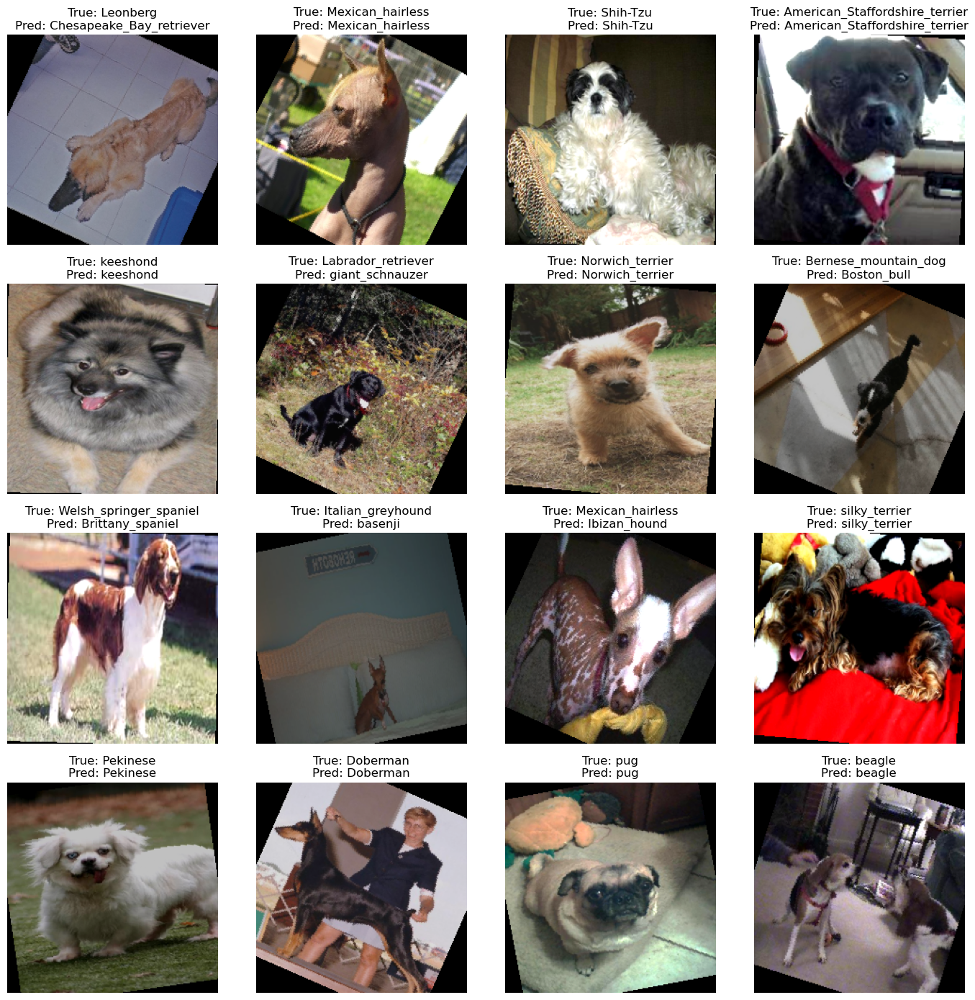

In [44]:
iterator = iter(test_loader_aug)

fig, axes = plt.subplots(4, 4, figsize=(14, 14))
axes = axes.ravel()

for i in range(16):
    image, label = next(iterator)
    pred_class = model(image.to(device)).softmax(1).argmax(1)
    # Plot the image with true and predicted labels
    axes[i].imshow(np.squeeze(image).permute(1, 2, 0))
    axes[i].set_title(f"True: {dog_breeds[label]}\nPred: {dog_breeds[pred_class]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

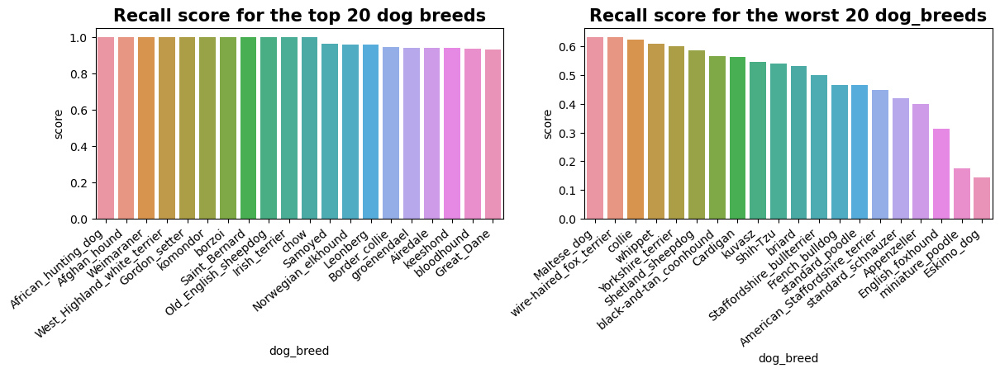

In [45]:
score_per_class(true_labels, predicted_labels, dog_breeds)

In [46]:
print(classification_report(true_labels, predicted_labels, target_names=dog_breeds))

                                precision    recall  f1-score   support

                     Chihuahua       0.50      0.88      0.64         8
              Japanese_spaniel       0.93      0.76      0.84        17
                   Maltese_dog       0.73      0.63      0.68        30
                      Pekinese       0.88      0.88      0.88        17
                      Shih-Tzu       0.87      0.54      0.67        24
              Blenheim_spaniel       0.90      0.90      0.90        20
                      papillon       0.79      0.92      0.85        12
                   toy_terrier       0.87      0.87      0.87        15
           Rhodesian_ridgeback       0.69      0.72      0.71        25
                  Afghan_hound       0.77      1.00      0.87        23
                        basset       0.74      0.85      0.79        20
                        beagle       0.71      0.71      0.71        28
                    bloodhound       0.88      0.94      0.91  

In [47]:
del model, iterator

### <font id='Sec.2.3'> C. CNN+Transformer using a variant of maxvit
    Source code of the model: https://github.com/huggingface/pytorch-image-models/blob/main/timm/models/maxxvit.py
    Related publications:
    - MaxViT: Multi-Axis Vision Transformer: https://arxiv.org/abs/2204.01697
    - A ConvNet for the 2020s: https://arxiv.org/abs/2201.03545
    - Swin Transformer V2: Scaling Up Capacity and Resolution: https://arxiv.org/abs/2111.09883

#### <font id='Sec.2.3.1'> a) Maxxvit-v2-base without augmentation

In [48]:
model = timm.create_model('maxxvitv2_rmlp_base_rw_224.sw_in12k_ft_in1k',
                          pretrained=True, drop_rate=0.2,
                         )
print('Classifier layer:', model.get_classifier())
print(model)

/opt/conda/lib/python3.10/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /usr/local/src/pytorch/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Classifier layer: Linear(in_features=1024, out_features=1000, bias=True)
MaxxVit(
  (stem): Stem(
    (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (norm1): LayerNormAct2d(
      (64,), eps=1e-06, elementwise_affine=True
      (drop): Identity()
      (act): GELU()
    )
    (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  )
  (stages): Sequential(
    (0): MaxxVitStage(
      (blocks): Sequential(
        (0): MaxxVitBlock(
          (conv): ConvNeXtBlock(
            (shortcut): Downsample2d(
              (pool): AvgPool2d(kernel_size=2, stride=2, padding=0)
              (expand): Identity()
            )
            (down): Identity()
            (conv_dw): Conv2d(128, 128, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), groups=128)
            (norm): LayerNorm2d((128,), eps=1e-06, elementwise_affine=True)
            (mlp): ConvMlp(
              (fc1): Conv2d(128, 512, kernel_size=(1, 1), st

In [49]:
# turns gradient calculations back on for the training the classification layer
torch.set_grad_enabled(True)

for param in model.parameters():
    param.requires_grad = False

model.head.fc = nn.Linear(model.head.fc.in_features, num_classes)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)
model.to(device)

cuda


MaxxVit(
  (stem): Stem(
    (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (norm1): LayerNormAct2d(
      (64,), eps=1e-06, elementwise_affine=True
      (drop): Identity()
      (act): GELU()
    )
    (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  )
  (stages): Sequential(
    (0): MaxxVitStage(
      (blocks): Sequential(
        (0): MaxxVitBlock(
          (conv): ConvNeXtBlock(
            (shortcut): Downsample2d(
              (pool): AvgPool2d(kernel_size=2, stride=2, padding=0)
              (expand): Identity()
            )
            (down): Identity()
            (conv_dw): Conv2d(128, 128, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), groups=128)
            (norm): LayerNorm2d((128,), eps=1e-06, elementwise_affine=True)
            (mlp): ConvMlp(
              (fc1): Conv2d(128, 512, kernel_size=(1, 1), stride=(1, 1))
              (norm): Identity()
              (act): GELU()

In [50]:
model.get_classifier()

Linear(in_features=1024, out_features=120, bias=True)

In [51]:
error = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [52]:
early_stopper = EarlyStopper(patience=5, min_delta=0.01)

num_epochs = 15
# Lists for visualization of loss and accuracy 
train_loss_list = []
val_loss_list = []
train_accuracy_list = []
val_accuracy_list = []

# Lists for knowing classwise accuracy
predictions_list = []
labels_list = []

len_train = len(train_loader)
len_val = len(val_loader)

best_loss = 1000

for epoch in range(num_epochs):
    print(f"Start of Epoch {epoch+1} of {num_epochs}")
    total_train = 0
    train_correct = 0
    train_loss = 0

    model.train()

    start = time.time()

    for it,(images, labels) in enumerate(train_loader):
        print(f'Train: {(it*100/len_train):.2f}% done out of {len_train} batch', end='\r')

        # Transfering images and labels to GPU if available
        images, labels = images.to(device), labels.to(device)

        # Forward pass 
        outputs = model(images)
        loss = error(outputs, labels)

        # update average validation loss
        train_loss += loss

        predictions = torch.max(outputs, 1)[1].to(device)
        train_correct += torch.sum(predictions == labels).item()
        total_train += len(labels)

        # Initializing a gradient as 0 so there is no mixing of gradient among the batches
        optimizer.zero_grad()

        # Propagating the error backward
        loss.backward()

        # Optimizing the parameters
        optimizer.step()

    print()

    # Testing the model

    total_val = 0
    val_correct = 0
    val_loss = 0

    model.eval()

    with torch.no_grad():
        for it, (images, labels) in enumerate(val_loader):
            print(f'Validation: {(it*100/len_val):.2f}% done out of {len_val} batch', end='\r')

            images, labels = images.to(device), labels.to(device)
            labels_list.append(labels)

            outputs = model(images)
            loss = error(outputs, labels)

            # update average validation loss
            val_loss += loss

            predictions = torch.max(outputs, 1)[1].to(device)
            val_correct += torch.sum(predictions == labels).item()
            total_val += len(labels)

    stop = time.time()
    training_time = stop - start

    val_accuracy = val_correct / total_val
    train_accuracy = train_correct / total_train
    val_accuracy_list.append(val_accuracy)
    train_accuracy_list.append(train_accuracy)
    val_loss = val_loss.tolist() / len_val
    train_loss = train_loss.tolist() / len_train
    val_loss_list.append(val_loss)
    train_loss_list.append(train_loss)

    print()

    if (val_loss < best_loss):
        best_loss = val_loss
        torch.save(model.state_dict(), f'maxvit_best_model.pth')
        print('Saving best model with best loss = ', best_loss)

    print("Epoch: {}, training_time: {:.2f}s, train_loss: {:.3f}, train_accuracy: {:.3f}, val_loss: {:.3f}, val_accuracy: {:.3f}\n"
          .format(epoch+1, training_time, train_loss, train_accuracy, val_loss, val_accuracy))

    if early_stopper.early_stop(val_loss):             
        break

Start of Epoch 1 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  0.2266581593727579
Epoch: 1, training_time: 284.94s, train_loss: 0.490, train_accuracy: 0.900, val_loss: 0.227, val_accuracy: 0.931

Start of Epoch 2 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  0.22005273857895208
Epoch: 2, training_time: 279.97s, train_loss: 0.172, train_accuracy: 0.945, val_loss: 0.220, val_accuracy: 0.935

Start of Epoch 3 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  0.21612838822968153
Epoch: 3, training_time: 280.55s, train_loss: 0.132, train_accuracy: 0.956, val_loss: 0.216, val_accuracy: 0.938

Start of Epoch 4 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Epoch: 4, training_time: 280.40s, train_loss: 0.113, train_accuracy: 0.961, val_loss: 0.219, va

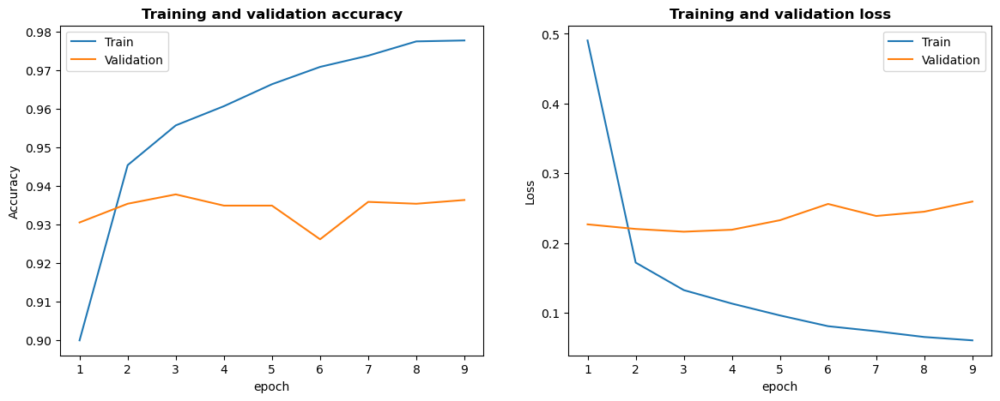

In [53]:
# Checking the accuracy and loss by epoch for both training and validation
epochs = range(1,  len(train_loss_list)+1)

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

axes[0].plot(epochs, train_accuracy_list)
axes[0].plot(epochs, val_accuracy_list)
axes[0].set_title('Training and validation accuracy',
                  fontsize=12, fontweight='bold')
axes[0].set_ylabel('Accuracy')
axes[0].set_xlabel('epoch') 
axes[0].legend(['Train', 'Validation'], loc='upper left')

axes[1].plot(epochs, train_loss_list)
axes[1].plot(epochs, val_loss_list)
axes[1].set_title('Training and validation loss',
                  fontsize=12, fontweight='bold')
axes[1].set_ylabel('Loss')
axes[1].set_xlabel('epoch') 
axes[1].legend(['Train', 'Validation'], loc='upper right')

plt.show()

#### <font id='Sec.2.3.2'> b) Evaluating the best Maxxvit-v2-base model without augmentation on test images

In [54]:
model = timm.create_model('maxxvitv2_rmlp_base_rw_224.sw_in12k_ft_in1k')
model.head.fc = nn.Linear(model.head.fc.in_features, num_classes)
model.load_state_dict(torch.load("./maxvit_best_model.pth"))

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)
model.to(device)

model.eval()

# This turns gradient calculations off for the test
torch.set_grad_enabled(False)

cuda


In [55]:
error = nn.CrossEntropyLoss()

len_test = len(test_loader)
test_loss = 0
test_correct = 0
total_test = 0

predicted_labels = []
true_labels = []

start = time.time()

for it, (images, labels) in enumerate(test_loader):
    print(f'Validation: {(it*100/len_test):.2f}% done out of {len_test} images', end='\r')
    images, labels = images.to(device), labels.to(device)
    outputs = model(images)
    loss = error(outputs, labels)
    # update average validation loss
    test_loss += loss
    
    predictions = torch.max(outputs, 1)[1].to(device)
    predicted_labels.append(predictions.tolist())
    true_labels.append(labels.tolist())
    test_correct += torch.sum(predictions == labels).item()

    total_test += len(labels)

stop = time.time()
test_time = stop - start

test_accuracy = test_correct / total_test
test_loss = test_loss.tolist() / len_test
    
print("Test time: {:.2f}s, test_loss: {:.3f}, test_accuracy: {:.3f}\n"
      .format(test_time, test_loss, test_accuracy))

score.append(['Maxvit_base', training_time, test_time, test_loss, test_accuracy])

Test time: 72.29s, test_loss: 0.211, test_accuracy: 0.941



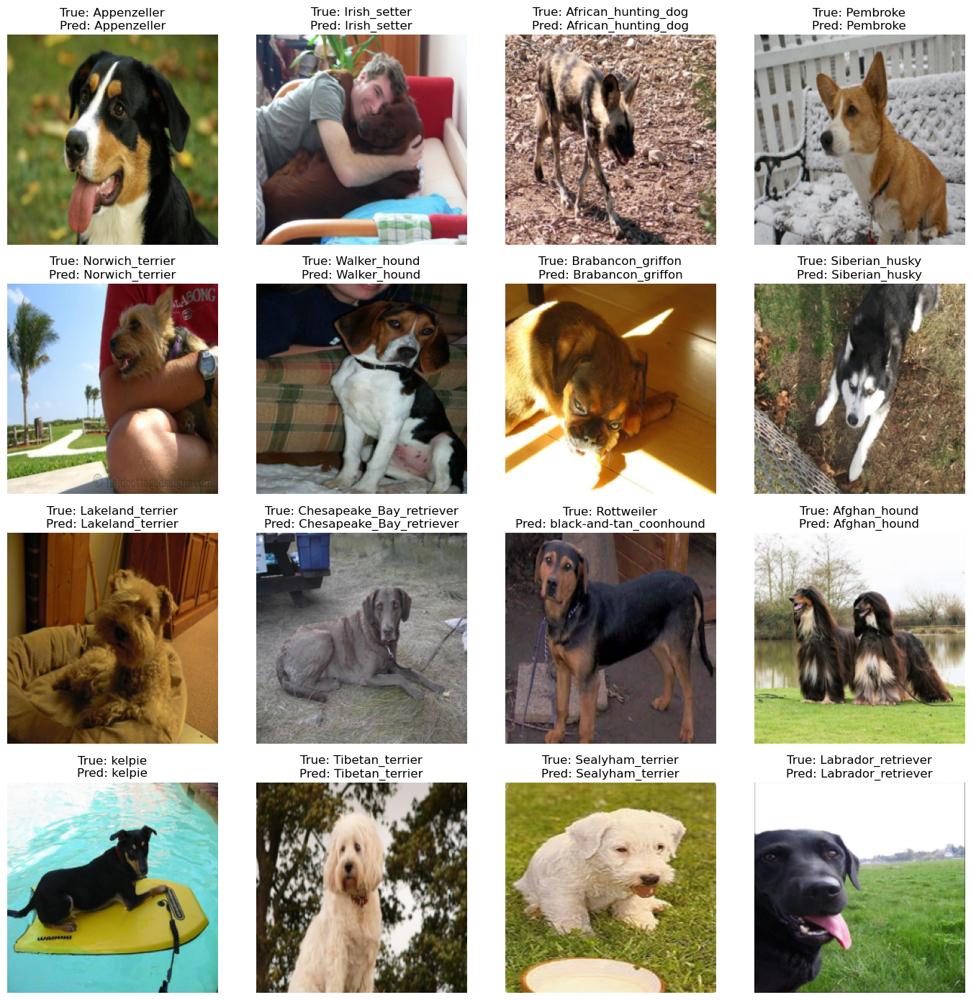

In [56]:
iterator = iter(test_loader)

fig, axes = plt.subplots(4, 4, figsize=(14, 14))
axes = axes.ravel()

for i in range(16):
    image, label = next(iterator)
    pred_class = model(image.to(device)).softmax(1).argmax(1)
    # Plot the image with true and predicted labels
    axes[i].imshow(np.squeeze(image).permute(1, 2, 0))
    axes[i].set_title(f"True: {dog_breeds[label]}\nPred: {dog_breeds[pred_class]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

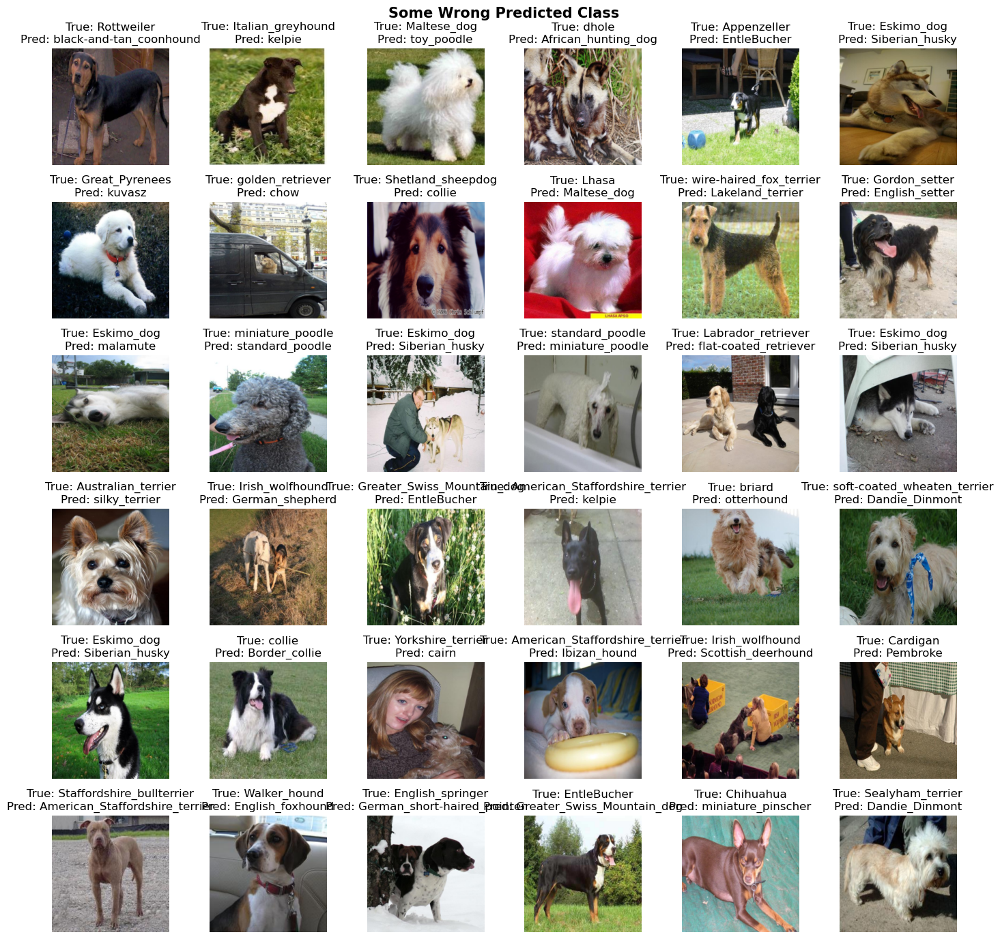

<Figure size 640x480 with 0 Axes>

In [57]:
iterator = iter(test_loader)

fig, axes = plt.subplots(6, 6, figsize=(14, 14))
axes = axes.ravel()
j = 0
for i in range(len(test_loader)):
    image, label = next(iterator)
    pred_class = model(image.to(device)).softmax(1).argmax(1)
    if (pred_class.tolist() != label.tolist()):
        # Plot the image with true and predicted labels
        if(j < len(axes)):
            axes[j].imshow(np.squeeze(image).permute(1, 2, 0))
            axes[j].set_title(f"True: {dog_breeds[label]}\nPred: {dog_breeds[pred_class]}")
            axes[j].axis("off")
            j+=1
        elif(j >= len(axes)):
            plt.suptitle('Some Wrong Predicted Class', fontsize=15, fontweight='bold')
            plt.tight_layout()
            plt.show()
            break

plt.suptitle('Some Wrong Predicted Class', fontsize=15, fontweight='bold')
plt.tight_layout()
plt.show()

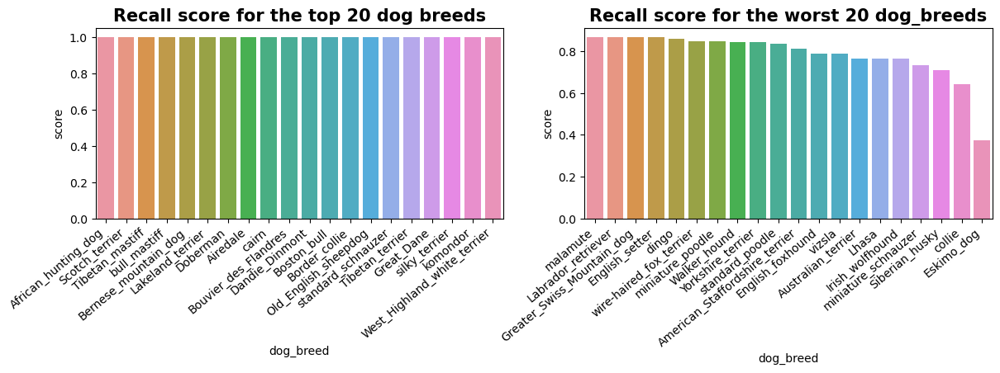

In [58]:
score_per_class(true_labels, predicted_labels, dog_breeds)

In [59]:
print(classification_report(true_labels, predicted_labels, target_names=dog_breeds))

                                precision    recall  f1-score   support

                     Chihuahua       0.94      0.94      0.94        18
              Japanese_spaniel       0.93      1.00      0.97        14
                   Maltese_dog       0.92      0.96      0.94        23
                      Pekinese       1.00      1.00      1.00        17
                      Shih-Tzu       0.90      1.00      0.95        19
              Blenheim_spaniel       1.00      1.00      1.00        14
                      papillon       1.00      0.94      0.97        16
                   toy_terrier       1.00      0.94      0.97        17
           Rhodesian_ridgeback       0.95      0.95      0.95        19
                  Afghan_hound       1.00      0.97      0.98        29
                        basset       0.92      1.00      0.96        12
                        beagle       1.00      0.95      0.98        21
                    bloodhound       1.00      0.94      0.97  

In [60]:
del model, iterator

#### <font id='Sec.2.3.3'> c) Maxxvit-v2-base with augmentation and training the last stage

In [61]:
model = timm.create_model('maxxvitv2_rmlp_base_rw_224.sw_in12k_ft_in1k',
                          pretrained=True, drop_rate=0.2,
                         )
print('Classifier layer:', model.get_classifier())
print(model)

Classifier layer: Linear(in_features=1024, out_features=1000, bias=True)
MaxxVit(
  (stem): Stem(
    (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (norm1): LayerNormAct2d(
      (64,), eps=1e-06, elementwise_affine=True
      (drop): Identity()
      (act): GELU()
    )
    (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  )
  (stages): Sequential(
    (0): MaxxVitStage(
      (blocks): Sequential(
        (0): MaxxVitBlock(
          (conv): ConvNeXtBlock(
            (shortcut): Downsample2d(
              (pool): AvgPool2d(kernel_size=2, stride=2, padding=0)
              (expand): Identity()
            )
            (down): Identity()
            (conv_dw): Conv2d(128, 128, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), groups=128)
            (norm): LayerNorm2d((128,), eps=1e-06, elementwise_affine=True)
            (mlp): ConvMlp(
              (fc1): Conv2d(128, 512, kernel_size=(1, 1), st

In [62]:
# turns gradient calculations back on for the training the classification layer
torch.set_grad_enabled(True)

for param in model.parameters():
    param.requires_grad = False

# model.stages[3] covers the last two blocks of the model
for param in model.stages[3].parameters():
    param.requires_grad = True
    
for param in model.head.parameters():
    param.requires_grad = True

model.head.fc = nn.Linear(model.head.fc.in_features, num_classes)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)
model.to(device)

cuda


MaxxVit(
  (stem): Stem(
    (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (norm1): LayerNormAct2d(
      (64,), eps=1e-06, elementwise_affine=True
      (drop): Identity()
      (act): GELU()
    )
    (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  )
  (stages): Sequential(
    (0): MaxxVitStage(
      (blocks): Sequential(
        (0): MaxxVitBlock(
          (conv): ConvNeXtBlock(
            (shortcut): Downsample2d(
              (pool): AvgPool2d(kernel_size=2, stride=2, padding=0)
              (expand): Identity()
            )
            (down): Identity()
            (conv_dw): Conv2d(128, 128, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), groups=128)
            (norm): LayerNorm2d((128,), eps=1e-06, elementwise_affine=True)
            (mlp): ConvMlp(
              (fc1): Conv2d(128, 512, kernel_size=(1, 1), stride=(1, 1))
              (norm): Identity()
              (act): GELU()

In [63]:
model.get_classifier()

Linear(in_features=1024, out_features=120, bias=True)

In [64]:
error = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [65]:
early_stopper = EarlyStopper(patience=5, min_delta=0.01)

num_epochs = 15

# Lists for visualization of loss and accuracy 
train_loss_list = []
val_loss_list = []
train_accuracy_list = []
val_accuracy_list = []

# Lists for knowing classwise accuracy
predictions_list = []
labels_list = []

len_train = len(train_loader_aug)
len_val = len(val_loader_aug)

best_loss = 1000

for epoch in range(num_epochs):
    print(f"Start of Epoch {epoch+1} of {num_epochs}")
    total_train = 0
    train_correct = 0
    train_loss = 0

    model.train()

    start = time.time()

    for it,(images, labels) in enumerate(train_loader_aug):
        print(f'Train: {(it*100/len_train):.2f}% done out of {len_train} batch', end='\r')

        # Transfering images and labels to GPU if available
        images, labels = images.to(device), labels.to(device)

        # Forward pass 
        outputs = model(images)
        loss = error(outputs, labels)

        # update average validation loss
        train_loss += loss

        predictions = torch.max(outputs, 1)[1].to(device)
        train_correct += torch.sum(predictions == labels).item()
        total_train += len(labels)

        # Initializing a gradient as 0 so there is no mixing of gradient among the batches
        optimizer.zero_grad()

        # Propagating the error backward
        loss.backward()

        # Optimizing the parameters
        optimizer.step()

    print()

    # Testing the model

    total_val = 0
    val_correct = 0
    val_loss = 0

    model.eval()

    with torch.no_grad():
        for it, (images, labels) in enumerate(val_loader_aug):
            print(f'Validation: {(it*100/len_val):.2f}% done out of {len_val} batch', end='\r')

            images, labels = images.to(device), labels.to(device)
            labels_list.append(labels)

            outputs = model(images)
            loss = error(outputs, labels)

            # update average validation loss
            val_loss += loss

            predictions = torch.max(outputs, 1)[1].to(device)
            val_correct += torch.sum(predictions == labels).item()
            total_val += len(labels)

    stop = time.time()
    training_time = stop - start

    val_accuracy = val_correct / total_val
    train_accuracy = train_correct / total_train
    val_accuracy_list.append(val_accuracy)
    train_accuracy_list.append(train_accuracy)
    val_loss = val_loss.tolist() / len_val
    train_loss = train_loss.tolist() / len_train
    val_loss_list.append(val_loss)
    train_loss_list.append(train_loss)

    print()

    if (val_loss < best_loss):
        best_loss = val_loss
        torch.save(model.state_dict(), f'maxvit_aug_best_model.pth')
        print('Saving best model with best loss = ', best_loss)

    print("Epoch: {}, training_time: {:.2f}s, train_loss: {:.3f}, train_accuracy: {:.3f}, val_loss: {:.3f}, val_accuracy: {:.3f}\n"
          .format(epoch+1, training_time, train_loss, train_accuracy, val_loss, val_accuracy))

    if early_stopper.early_stop(val_loss):             
        break

Start of Epoch 1 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  0.5460946219308036
Epoch: 1, training_time: 322.09s, train_loss: 0.813, train_accuracy: 0.774, val_loss: 0.546, val_accuracy: 0.841

Start of Epoch 2 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  0.4685951544314015
Epoch: 2, training_time: 320.71s, train_loss: 0.444, train_accuracy: 0.858, val_loss: 0.469, val_accuracy: 0.852

Start of Epoch 3 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Epoch: 3, training_time: 321.10s, train_loss: 0.339, train_accuracy: 0.892, val_loss: 0.477, val_accuracy: 0.860

Start of Epoch 4 of 15
Train: 99.74% done out of 392 batch
Validation: 97.96% done out of 49 batch
Saving best model with best loss =  0.46324761059819436
Epoch: 4, training_time: 321.54s, train_loss: 0.276, train_accuracy: 0.911, val_loss: 0.463, val

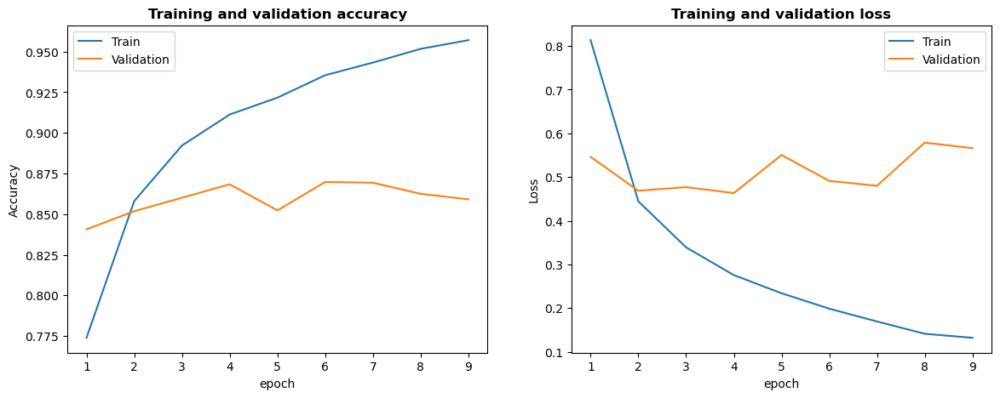

In [66]:
# Checking the accuracy and loss by epoch for both training and validation
epochs = range(1,  len(train_loss_list)+1)

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

axes[0].plot(epochs, train_accuracy_list)
axes[0].plot(epochs, val_accuracy_list)
axes[0].set_title('Training and validation accuracy',
                  fontsize=12, fontweight='bold')
axes[0].set_ylabel('Accuracy')
axes[0].set_xlabel('epoch') 
axes[0].legend(['Train', 'Validation'], loc='upper left')

axes[1].plot(epochs, train_loss_list)
axes[1].plot(epochs, val_loss_list)
axes[1].set_title('Training and validation loss',
                  fontsize=12, fontweight='bold')
axes[1].set_ylabel('Loss')
axes[1].set_xlabel('epoch') 
axes[1].legend(['Train', 'Validation'], loc='upper right')

plt.show()

#### <font id='Sec.2.3.4'> d) Evaluating the best Maxxvit-v2-base model with augmentation on test images

In [67]:
model = timm.create_model('maxxvitv2_rmlp_base_rw_224.sw_in12k_ft_in1k')
model.head.fc = nn.Linear(model.head.fc.in_features, num_classes)
model.load_state_dict(torch.load("./maxvit_aug_best_model.pth"))

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)
model.to(device)

model.eval()

# This turns gradient calculations off for the test
torch.set_grad_enabled(False)

cuda


In [68]:
error = nn.CrossEntropyLoss()

len_test = len(test_loader_aug)
test_loss = 0
test_correct = 0
total_test = 0

predicted_labels = []
true_labels = []

start = time.time()

for it, (images, labels) in enumerate(test_loader_aug):
    print(f'Validation: {(it*100/len_test):.2f}% done out of {len_test} images', end='\r')
    images, labels = images.to(device), labels.to(device)
    outputs = model(images)
    loss = error(outputs, labels)
    # update average validation loss
    test_loss += loss
    
    predictions = torch.max(outputs, 1)[1].to(device)
    predicted_labels.append(predictions.tolist())
    true_labels.append(labels.tolist())
    test_correct += torch.sum(predictions == labels).item()

    total_test += len(labels)

stop = time.time()
test_time = stop - start

test_accuracy = test_correct / total_test
test_loss = test_loss.tolist() / len_test
    
print("Test time: {:.2f}s, test_loss: {:.3f}, test_accuracy: {:.3f}\n"
      .format(test_time, test_loss, test_accuracy))

score.append(['Maxvit_base_aug', training_time, test_time, test_loss, test_accuracy])

Test time: 76.56s, test_loss: 0.511, test_accuracy: 0.862



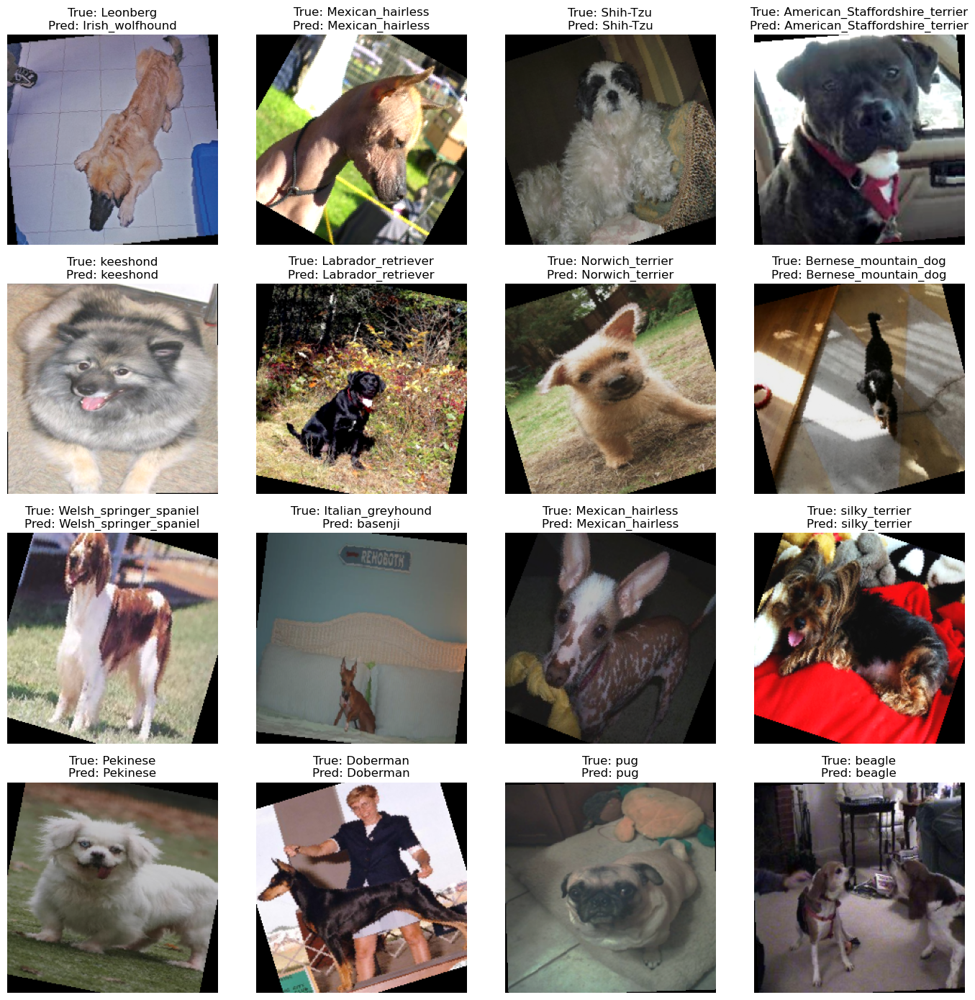

In [69]:
iterator = iter(test_loader_aug)

fig, axes = plt.subplots(4, 4, figsize=(14, 14))
axes = axes.ravel()

for i in range(16):
    image, label = next(iterator)
    pred_class = model(image.to(device)).softmax(1).argmax(1)
    # Plot the image with true and predicted labels
    axes[i].imshow(np.squeeze(image).permute(1, 2, 0))
    axes[i].set_title(f"True: {dog_breeds[label]}\nPred: {dog_breeds[pred_class]}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

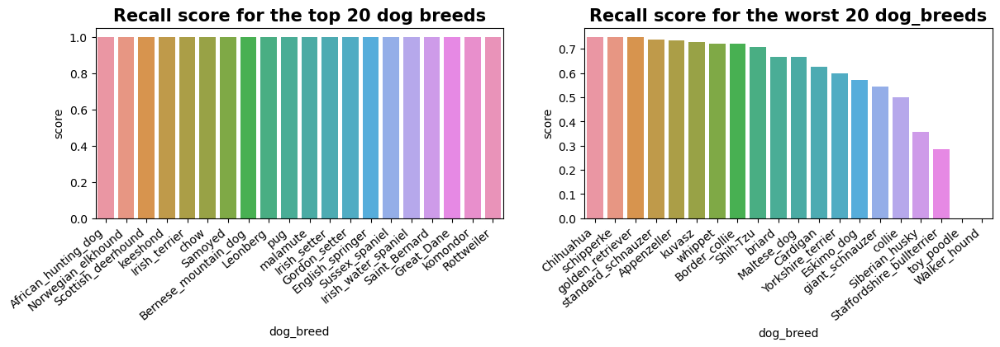

In [70]:
score_per_class(true_labels, predicted_labels, dog_breeds)

In [71]:
print(classification_report(true_labels, predicted_labels, target_names=dog_breeds))

                                precision    recall  f1-score   support

                     Chihuahua       0.67      0.75      0.71         8
              Japanese_spaniel       0.94      0.88      0.91        17
                   Maltese_dog       0.83      0.67      0.74        30
                      Pekinese       0.83      0.88      0.86        17
                      Shih-Tzu       0.85      0.71      0.77        24
              Blenheim_spaniel       0.95      1.00      0.98        20
                      papillon       0.92      0.92      0.92        12
                   toy_terrier       0.82      0.93      0.87        15
           Rhodesian_ridgeback       0.83      0.96      0.89        25
                  Afghan_hound       1.00      0.96      0.98        23
                        basset       0.87      1.00      0.93        20
                        beagle       0.66      0.82      0.73        28
                    bloodhound       1.00      0.88      0.93  

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [72]:
del model, iterator

### <font id='Sec.2.4'> D. Summary on the modelisation

In [73]:
# Putting the scores in pandas dataframe
score_df = pd.DataFrame(score,
                        columns=['Model', 'Training_time',
                                'Testing_time', 'Test_loss',
                                'Test_accuracy'])
score_df

,Model,Training_time,Testing_time,Test_loss,Test_accuracy
0,Resnet50,100.120246,23.623259,0.678789,0.812925
1,Resnet50_aug,136.129423,26.869394,0.815892,0.771137
2,Maxvit_base,281.083997,72.290240,0.211166,0.941205
3,Maxvit_base_aug,320.800820,76.563622,0.510659,0.861516


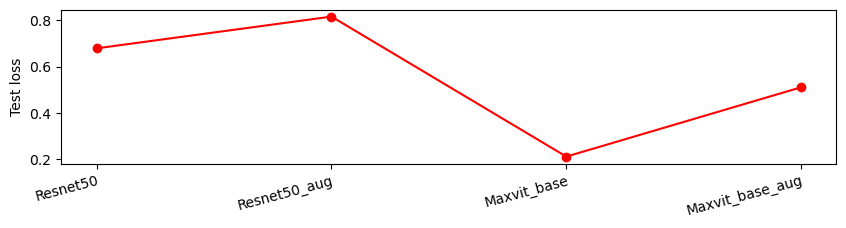

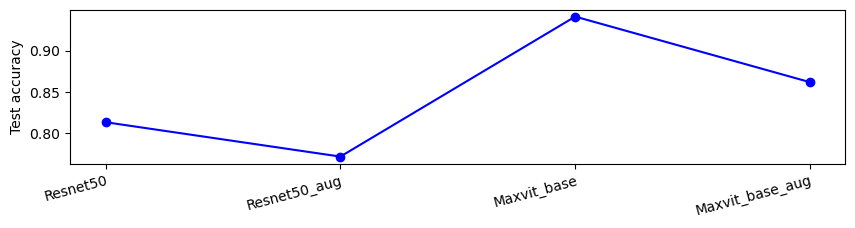

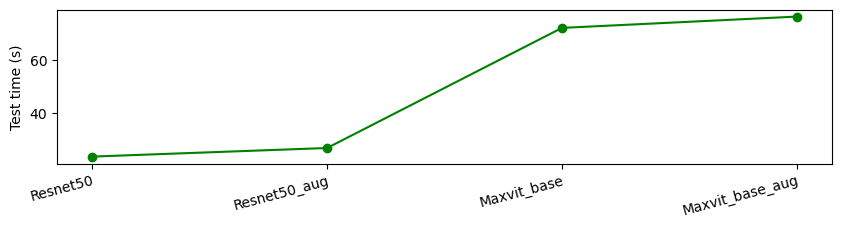

In [74]:
# Plotting the comparaison between the differents test in terms of test loss and accuracy 
plt.figure(figsize = (10, 2))
plt.plot(score_df['Model'], score_df['Test_loss'],
         c='red',marker='o', markerfacecolor='red')
plt.xticks(ha='right', rotation=15, rotation_mode='anchor')
plt.ylabel('Test loss')
plt.show()

plt.figure(figsize = (10, 2))
plt.plot(score_df['Model'], score_df['Test_accuracy'],
         c='blue', marker='o', markerfacecolor='blue')
plt.xticks(ha='right', rotation=15, rotation_mode='anchor')
plt.ylabel('Test accuracy')
plt.show()

plt.figure(figsize = (10, 2))
plt.plot(score_df['Model'], score_df['Testing_time'],
         c='green', marker='o', markerfacecolor='green')
plt.xticks(ha='right', rotation=15, rotation_mode='anchor')
plt.ylabel('Test time (s)')
plt.show()

- Two models tested in this project, one is pure CNN, Resnet-50, and one is combination of CNN and transformers, Maxxvit_v2_base.
- Maxxvit_v2_base gave better results in terms of test accuracy and test loss but 3 times slower to predict the class of a dog in a image.
- Image augmentation and learning the last few blocks of Resnet-50 and Maxxvit_v2_base did not improve the test scores.
- We were able to achive a test accuracy of 94 % with Maxxvit_v2_base, the 6% wrongly predicted images can be due to many reasons:
    - the presence of multiple dogs in an image,
    - very close dog breed in characteristics,
    - dog accupying very small part of the image.